In [2]:
import pandas as pd
import anndata as ad
from loguru import logger 
import time

import numpy as np
import tifffile

import matplotlib.pyplot as plt
import seaborn as sns

import shapely
import geopandas as gpd

import os
import sys
sys.path.append(os.path.abspath('../scripts'))
import utils
import importlib

import scimap as sm

Running SCIMAP  2.1.3


In [2]:
sample_id = 991

path_to_quant = f"../data/quantification/{sample_id}_backsub_quantification.csv"
path_to_geojson = f"../data/geojsons/{sample_id}.geojson"
# path_to_gates = "../data/phenotyping/20240918_gates.csv"
path_to_phenotype_matrix = "../data/phenotyping/20240905_PhenotypeMatrix_v3.csv"

# Basic filtering

In [3]:
importlib.reload(utils)
adata = utils.read_quant(path_to_quant)

2024-10-12 12:27:27.285 | INFO     | utils:read_quant:26 -  ---- read_quant : version number 1.1.0 ----
2024-10-12 12:27:30.860 | INFO     | utils:read_quant:46 -  685805 cells and 75 variables
2024-10-12 12:27:30.864 | INFO     | utils:read_quant:47 -  ---- read_quant is done, took 3s  ----


2024-10-02 11:04:43.228 | INFO     | utils:filter_by_annotation:170 -  ---- filter_by_annotation : version number 1.2.0 ----
2024-10-02 11:04:43.370 | INFO     | utils:filter_by_annotation:176 - GeoJson loaded, detected: 17 annotations
2024-10-02 11:05:44.490 | INFO     | utils:filter_by_annotation:188 - Labelled cells with annotations if they were found inside
2024-10-02 11:05:44.514 | INFO     | utils:filter_by_annotation:189 - Number of cells not found inside any annotation: 665091


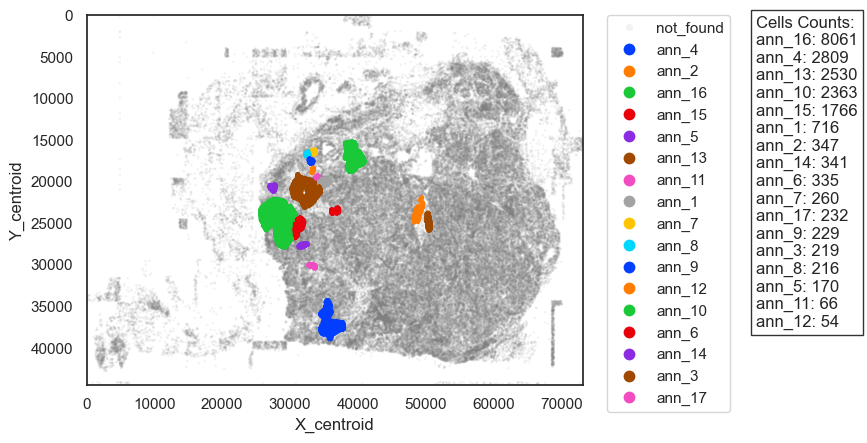

2024-10-02 11:05:45.457 | INFO     | utils:filter_by_annotation:221 -  ---- filter_by_annotation is done, took 62s  ----


In [5]:
adata = utils.filter_by_annotation(adata, path_to_geojson=path_to_geojson)

/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/pandas/core/internals/blocks.py:393: RuntimeWarning:

divide by zero encountered in log10



Threshold for DAPI intensity: 100.00
Threshold for DAPI intensity: 3162.28


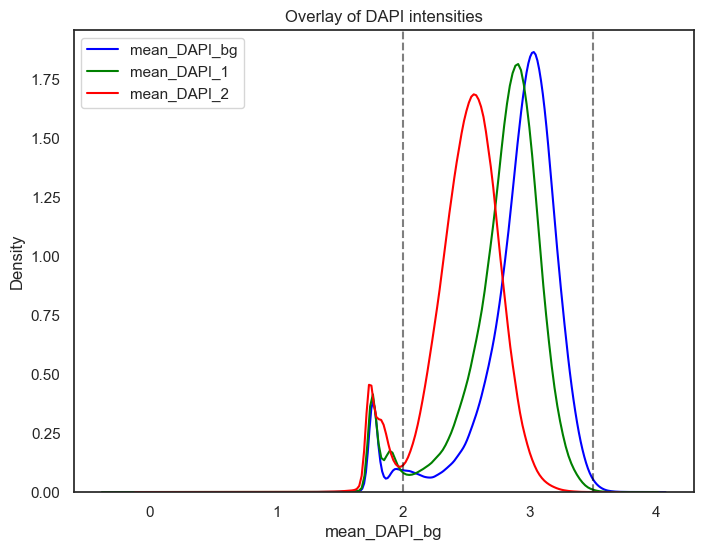

In [6]:
# Plot the density plot for each column
plt.figure(figsize=(8,6))
tmp_df = np.log10(pd.DataFrame(adata.X, columns=adata.var_names))
sns.kdeplot(tmp_df['mean_DAPI_bg'], label='mean_DAPI_bg', color='blue')
sns.kdeplot(tmp_df['mean_DAPI_1'], label='mean_DAPI_1', color='green')
sns.kdeplot(tmp_df['mean_DAPI_2'], label='mean_DAPI_2', color='red')

low_threshold = 2
plt.axvline(low_threshold, color='black', linestyle='--', alpha=0.5)
print(f"Threshold for DAPI intensity: {10**low_threshold:.2f}")

high_threshold = 3.5
plt.axvline(high_threshold, color='black', linestyle='--', alpha=0.5)
print(f"Threshold for DAPI intensity: {10**high_threshold:.2f}")

plt.title('Overlay of DAPI intensities')
plt.legend()
plt.show()

2024-10-02 11:06:13.292 | INFO     | utils:filter_by_abs_value:227 -  ---- filter_by_abs_value : version number 1.0.0 ----
2024-10-02 11:06:13.343 | INFO     | utils:filter_by_abs_value:243 - Number of cells with mean_DAPI_bg above 100: 653466


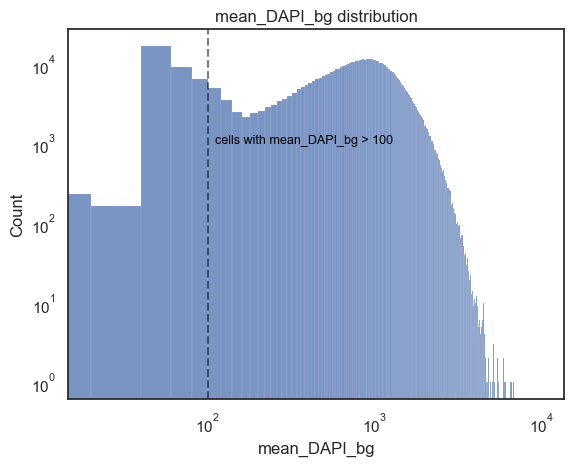

2024-10-02 11:06:14.000 | INFO     | utils:filter_by_abs_value:265 -  ---- filter_by_abs_value is done, took 0s  ----
2024-10-02 11:06:14.000 | INFO     | utils:filter_by_abs_value:227 -  ---- filter_by_abs_value : version number 1.0.0 ----
2024-10-02 11:06:14.025 | INFO     | utils:filter_by_abs_value:248 - Number of cells with mean_DAPI_bg below 3162: 683930


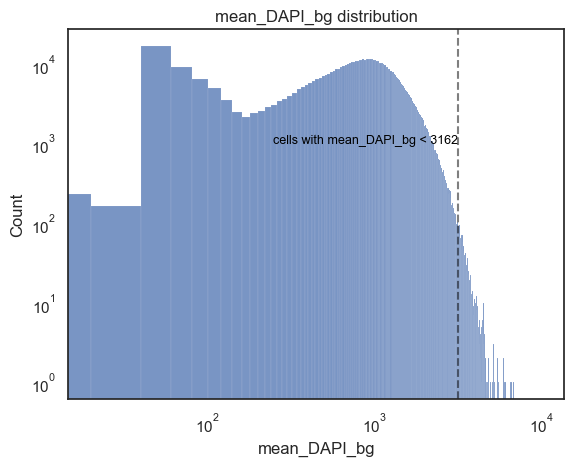

2024-10-02 11:06:14.617 | INFO     | utils:filter_by_abs_value:265 -  ---- filter_by_abs_value is done, took 0s  ----


In [7]:
adata = utils.filter_by_abs_value(adata=adata, marker="mean_DAPI_bg", value=100, direction="above")
adata = utils.filter_by_abs_value(adata=adata, marker="mean_DAPI_bg", value=3162, direction="below")

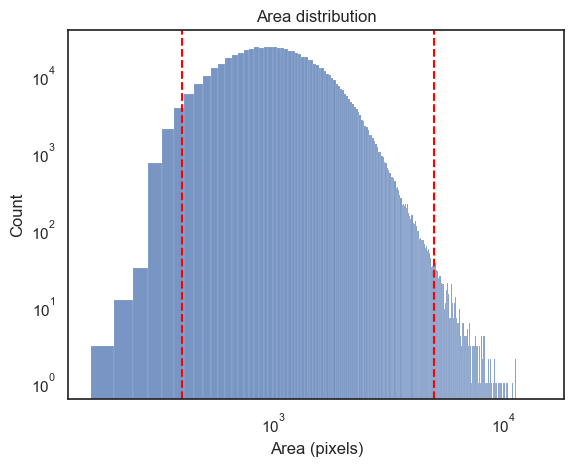

In [8]:
sns.histplot(adata.obs['Area'], bins=350)
plt.yscale('log')
plt.xscale('log')
plt.title('Area distribution')
plt.xlabel('Area (pixels)')
plt.axvline(400, color='red', linestyle='--')
plt.axvline(5000, color='red', linestyle='--')
plt.show()

In [9]:
adata.obs['Area_filter_nottoobig'] = adata.obs['Area'] < 5000
adata.obs['Area_filter_nottoolow'] = adata.obs['Area'] > 400
adata.obs['Area_filter'] = adata.obs['Area_filter_nottoobig'] & adata.obs['Area_filter_nottoolow']

#print stats
print("Number of cells before filtering: ", adata.shape[0])
print("Number of cells filtered out by Area: ", adata.shape[0] - adata.obs['Area_filter'].sum())
print("Percentage of cells filtered out by Area: ", round((adata.shape[0] - adata.obs['Area_filter'].sum())/adata.shape[0]*100, 3), "%")

Number of cells before filtering:  685805
Number of cells filtered out by Area:  6269
Percentage of cells filtered out by Area:  0.914 %


2024-10-02 11:06:23.408 | INFO     | utils:filter_by_ratio:123 -  ---- filter_by_ratio : version number 1.1.0 ----
2024-10-02 11:06:23.452 | INFO     | utils:filter_by_ratio:141 - Number of cells with DAPI ratio < 0.15: 20618
2024-10-02 11:06:23.481 | INFO     | utils:filter_by_ratio:142 - Number of cells with DAPI ratio > 1.05: 5125
2024-10-02 11:06:23.507 | INFO     | utils:filter_by_ratio:143 - Number of cells with DAPI ratio between 0.15 and 1.05: 659829
2024-10-02 11:06:23.532 | INFO     | utils:filter_by_ratio:144 - Percentage of cells filtered out: 3.79%


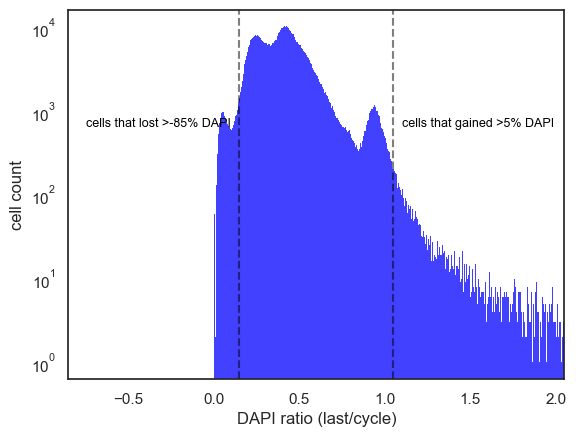

2024-10-02 11:06:25.813 | INFO     | utils:filter_by_ratio:164 -  ---- filter_by_ratio is done, took 2s  ----


In [10]:
adata = utils.filter_by_ratio(
    adata=adata, 
    end_cycle="mean_DAPI_2", 
    start_cycle="mean_DAPI_bg", 
    label="DAPI",
    min_ratio=0.15,
    max_ratio=1.05,
    )

In [11]:
adata = adata[adata.obs['filter_by_ann'].astype(bool) & adata.obs['mean_DAPI_bg_abs_below_value'] & adata.obs['mean_DAPI_bg_abs_above_value'] & adata.obs['Area_filter'] & adata.obs['DAPI_ratio_pass']]

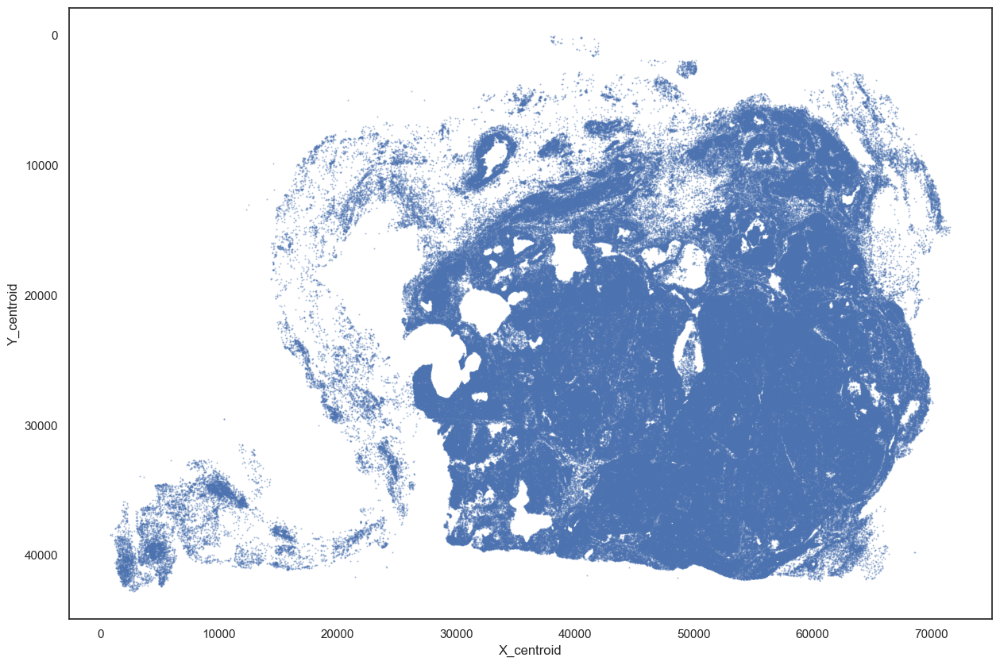

In [12]:
sns.scatterplot(data=adata.obs, x='X_centroid', y='Y_centroid', linewidth=0, s=2, alpha=0.5)
fig = plt.gcf()
fig.set_size_inches(15, 10)
#flip y axis
plt.gca().invert_yaxis()
plt.show()

# Start phenotyping

In [15]:
importlib.reload(utils)
path_to_gates = "../data/phenotyping/20241002_gates.csv"
gates = utils.read_gates(path_to_gates, sample_id=991)

2024-10-02 11:07:28.093 | INFO     | utils:read_gates:50 -  ---- read_gates : version number 1.1.0 ----
2024-10-02 11:07:28.096 | INFO     | utils:read_gates:56 -    Filtering out all rows with value 0.0 (assuming not gated)
2024-10-02 11:07:28.097 | INFO     | utils:read_gates:59 -   Found 8 valid gates
2024-10-02 11:07:28.097 | INFO     | utils:read_gates:60 -   Markers found: ['mean_Vimentin' 'mean_CD3e' 'mean_panCK' 'mean_CD8' 'mean_COL1A1'
 'mean_CD20' 'mean_CD68' 'mean_Ki67']
2024-10-02 11:07:28.098 | INFO     | utils:read_gates:61 -   Samples found: [991]
2024-10-02 11:07:28.099 | INFO     | utils:read_gates:66 -   Found 8 valid gates for sample 991
2024-10-02 11:07:28.100 | INFO     | utils:read_gates:68 -  ---- read_gates is done, took 0s  ----


In [16]:
adata.obs['imageid'] = "991"
gates_processed = utils.process_gates_for_sm(gates, sample_id="991")

/var/folders/x7/grkjlk8s223dy6234rnz1885mxz2_6/T/ipykernel_62767/2690740491.py:1: ImplicitModificationWarning:

Trying to modify attribute `.obs` of view, initializing view as actual.

2024-10-02 11:07:36.921 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 11:07:36.923 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----


In [17]:
#save adata as checkpoint
adata.write("../data/processed/20241002_991.h5ad")

adata = adata[:, adata.var_names.str.contains("mean")]

In [23]:
adata = adata[:, adata.var_names.isin(gates['marker_id'])]

In [25]:
adata

View of AnnData object with n_obs × n_vars = 610182 × 8
    obs: 'CellID', 'Y_centroid', 'X_centroid', 'Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity', 'filter_by_ann', 'mean_DAPI_bg_abs_above_value', 'mean_DAPI_bg_abs_below_value', 'Area_filter_nottoobig', 'Area_filter_nottoolow', 'Area_filter', 'DAPI_ratio', 'DAPI_ratio_pass_nottoolow', 'DAPI_ratio_pass_nottoohigh', 'DAPI_ratio_pass', 'imageid'
    var: 'math', 'marker'

In [28]:
adata.var_names

Index(['mean_Vimentin', 'mean_CD3e', 'mean_panCK', 'mean_CD8', 'mean_COL1A1',
       'mean_CD20', 'mean_CD68', 'mean_Ki67'],
      dtype='object')

In [29]:
gates_processed

,marker,991
0,mean_Vimentin,6.355032
1,mean_CD3e,5.993961
2,mean_panCK,3.931826
3,mean_CD8,7.090910
4,mean_COL1A1,7.186144
5,mean_CD20,6.685861
6,mean_CD68,5.607937
7,mean_Ki67,2.949953


2024-10-02 11:12:54.658 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----
2024-10-02 11:12:54.714 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 11:12:54.715 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 11:12:54.717 | INFO     | utils:phenotype_with_gate_change:305 - processed gate       marker       991
1  mean_CD3e  5.993961
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:105: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is depr

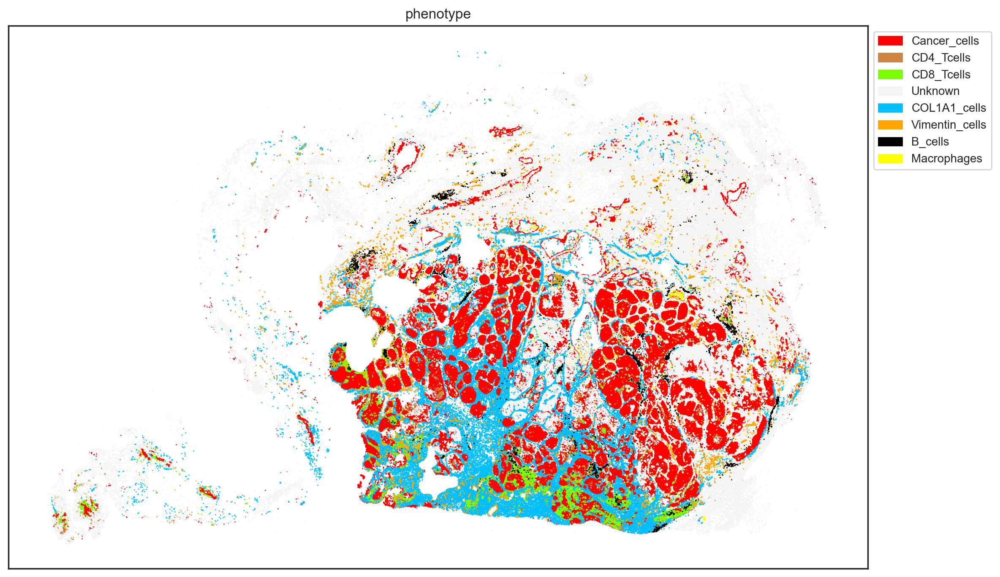

In [30]:
# phenotype on adata copy
utils.phenotype_with_gate_change(
    adata=adata,
    gates=gates,
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="991",
    marker = "mean_CD3e",
    new_gate = 400
)

2024-10-02 11:13:48.844 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----
2024-10-02 11:13:48.992 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 11:13:48.993 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 11:13:48.994 | INFO     | utils:phenotype_with_gate_change:305 - processed gate       marker       991
1  mean_CD3e  5.860786
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:105: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is depr

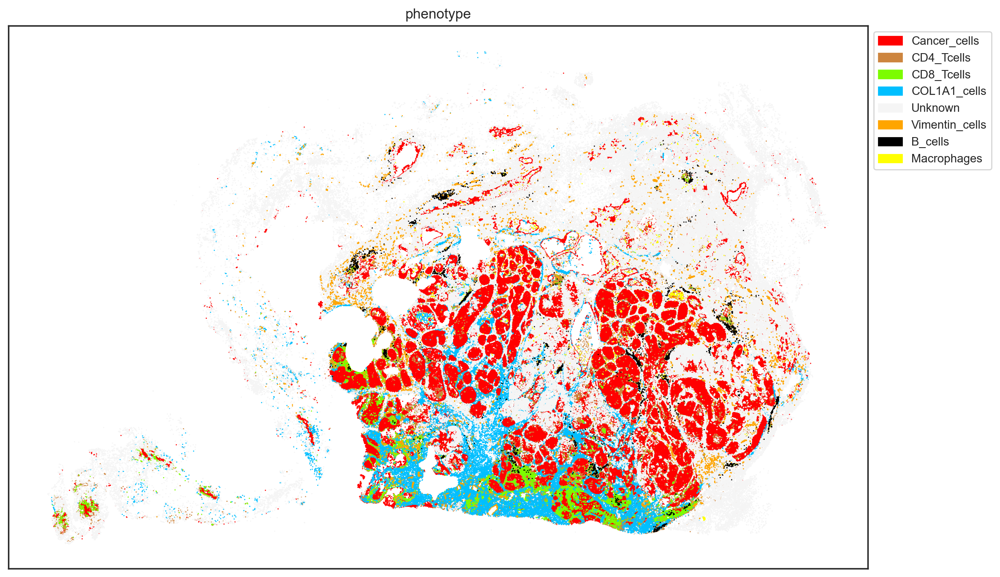

In [31]:
# phenotype on adata copy
utils.phenotype_with_gate_change(
    adata=adata,
    gates=gates,
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="991",
    marker = "mean_CD3e",
    new_gate = 350
)

2024-10-02 11:13:48.844 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----
2024-10-02 11:13:48.992 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 11:13:48.993 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 11:13:48.994 | INFO     | utils:phenotype_with_gate_change:305 - processed gate       marker       991
1  mean_CD3e  5.860786
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:105: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is depr

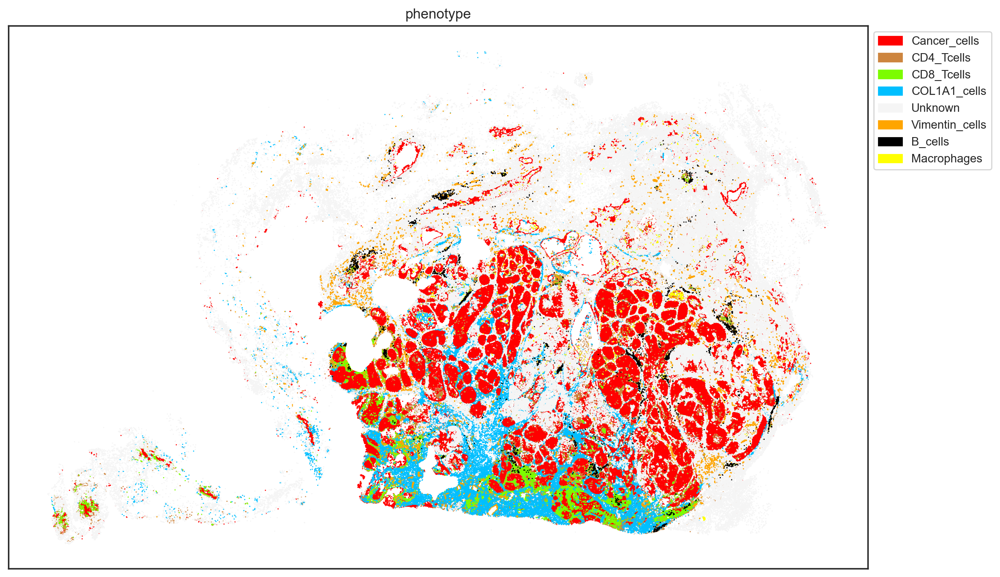

In [ ]:
# phenotype on adata copy
utils.phenotype_with_gate_change(
    adata=adata,
    gates=gates,
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="991",
    marker = "mean_CD3e",
    new_gate = 350
)

2024-10-02 11:32:35.132 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----
2024-10-02 11:32:35.289 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 11:32:35.291 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 11:32:35.292 | INFO     | utils:phenotype_with_gate_change:305 - processed gate Empty DataFrame
Columns: [marker, 991]
Index: []
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:105: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is d

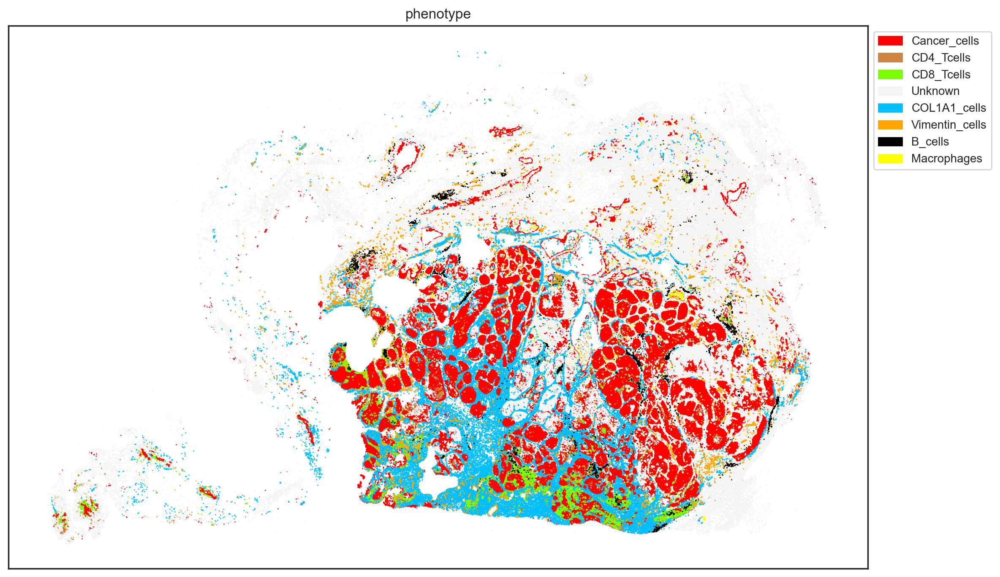

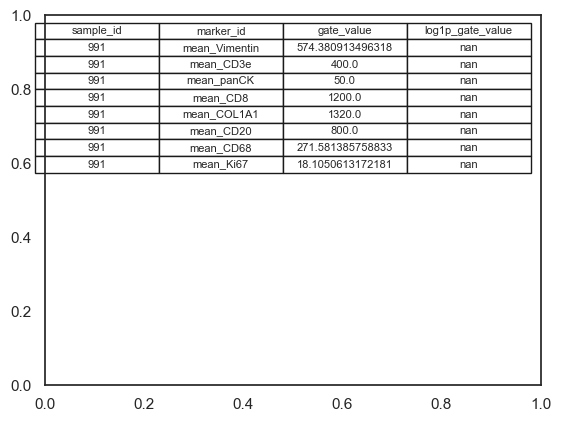

In [34]:
# too many CD8, that should be CD4

importlib.reload(utils)

utils.phenotype_with_gate_change(
    adata=adata,
    gates=gates,
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="991",
    marker = "mean_CD8a",
    new_gate = 400
)

2024-10-02 11:33:18.412 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----
2024-10-02 11:33:18.546 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 11:33:18.547 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 11:33:18.548 | INFO     | utils:phenotype_with_gate_change:305 - processed gate Empty DataFrame
Columns: [marker, 991]
Index: []
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:105: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is d

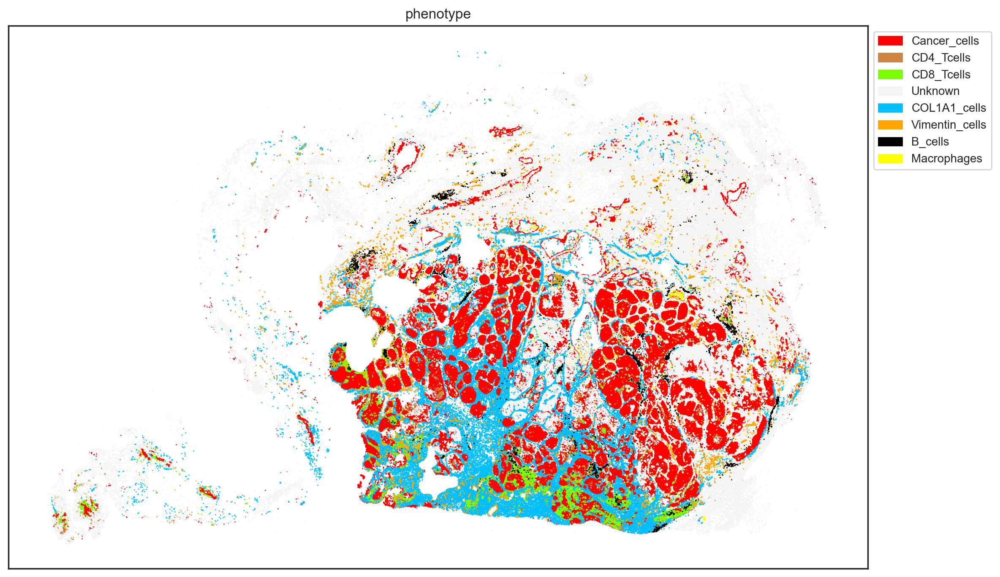

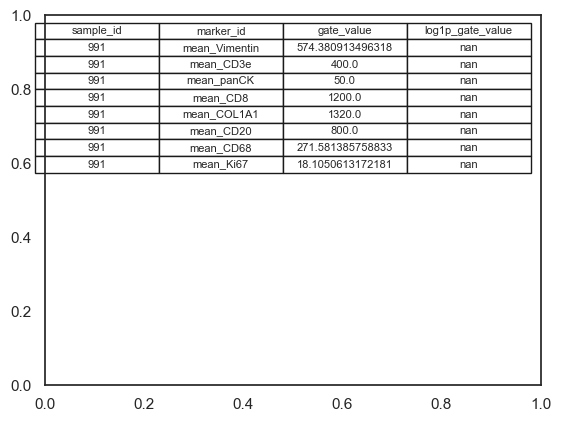

In [35]:
# too many CD8, that should be CD4

importlib.reload(utils)

utils.phenotype_with_gate_change(
    adata=adata,
    gates=gates,
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="991",
    marker = "mean_CD8a",
    new_gate = 400
)

2024-10-02 11:34:12.641 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----
2024-10-02 11:34:12.794 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 11:34:12.795 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 11:34:12.796 | INFO     | utils:phenotype_with_gate_change:305 - processed gate Empty DataFrame
Columns: [marker, 991]
Index: []
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:105: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is d

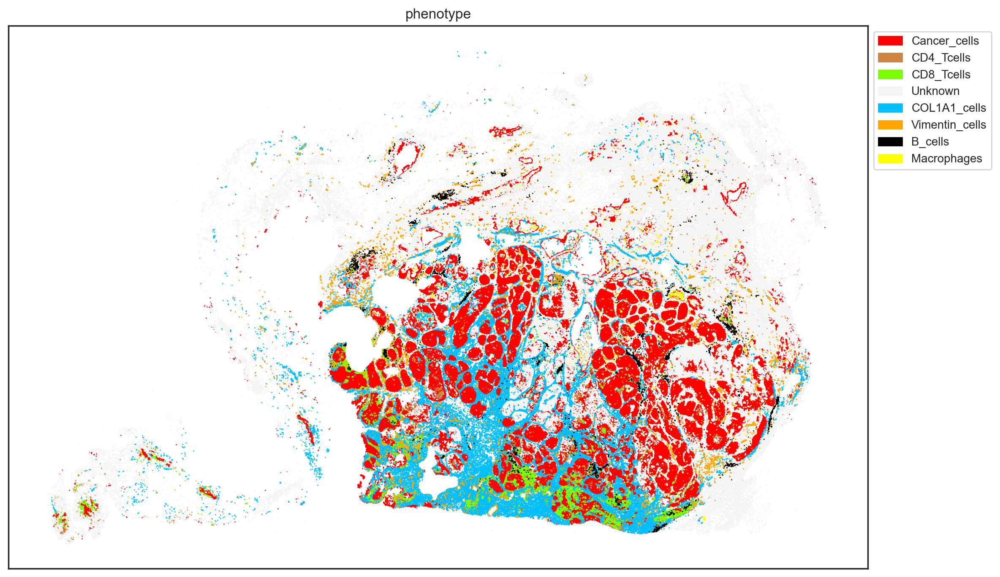

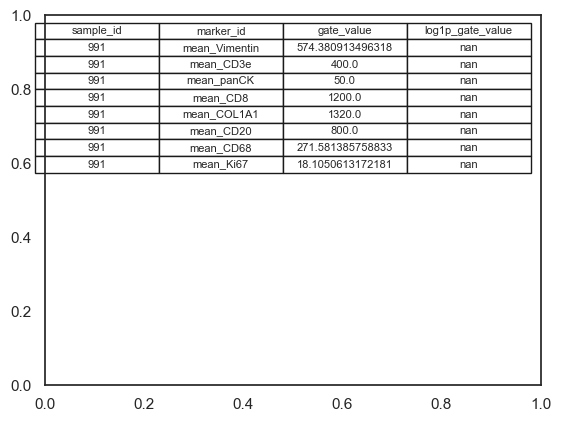

In [36]:
# too many CD8, that should be CD4

importlib.reload(utils)

utils.phenotype_with_gate_change(
    adata=adata,
    gates=gates,
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="991",
    marker = "mean_CD8a",
    new_gate = 1200
)

2024-10-02 11:34:47.873 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----
2024-10-02 11:34:47.999 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 11:34:48.001 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 11:34:48.003 | INFO     | utils:phenotype_with_gate_change:305 - processed gate Empty DataFrame
Columns: [marker, 991]
Index: []
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:105: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is d

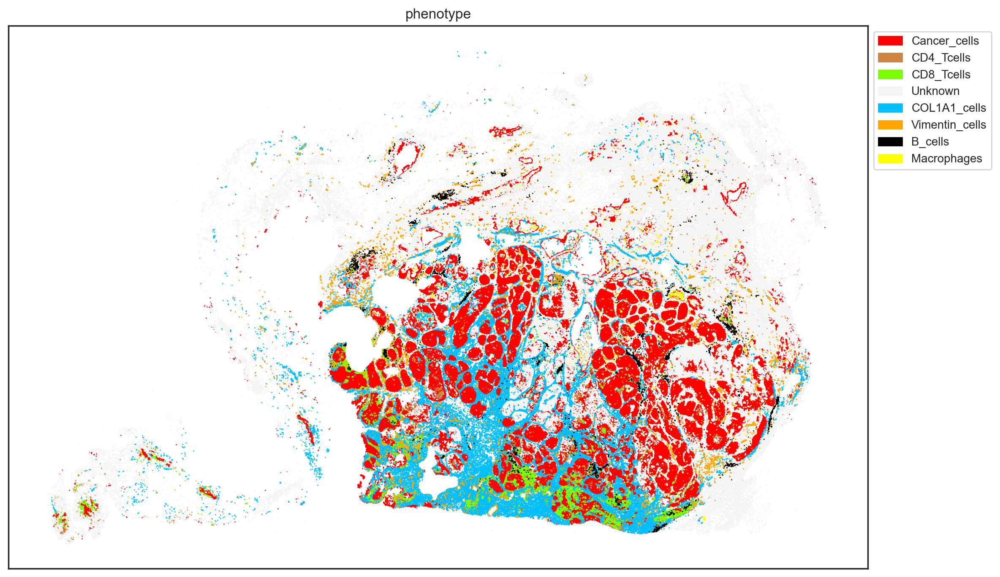

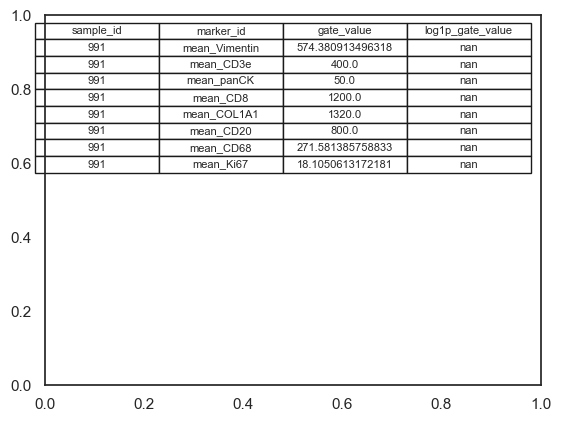

In [37]:
# too many CD8, that should be CD4

importlib.reload(utils)

utils.phenotype_with_gate_change(
    adata=adata,
    gates=gates,
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="991",
    marker = "mean_CD8a",
    new_gate = 1500
)

2024-10-02 12:05:17.311 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----
2024-10-02 12:05:17.460 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 12:05:17.462 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 12:05:17.464 | INFO     | utils:phenotype_with_gate_change:305 - processed gate      marker      991
3  mean_CD8  7.09091
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:105: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecat

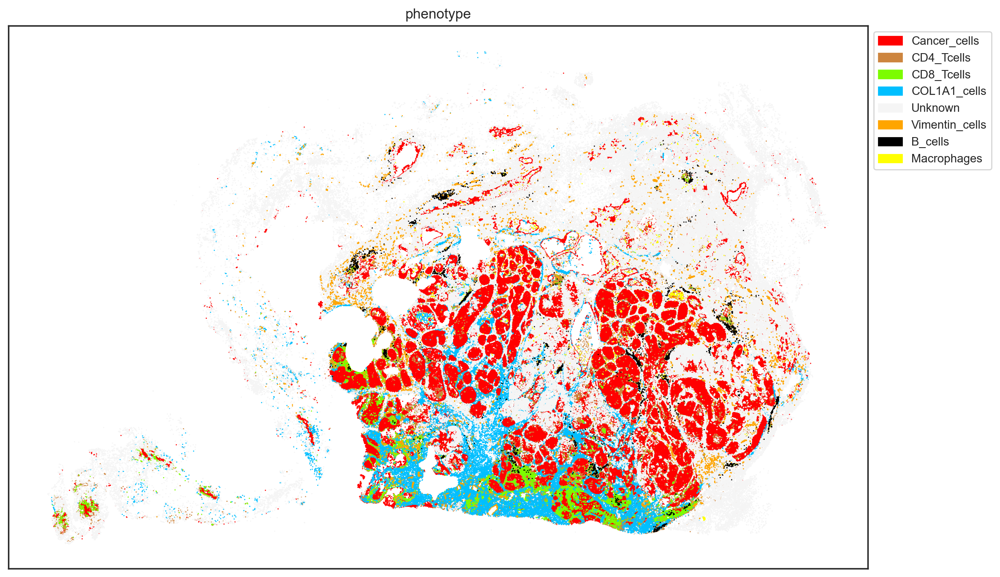

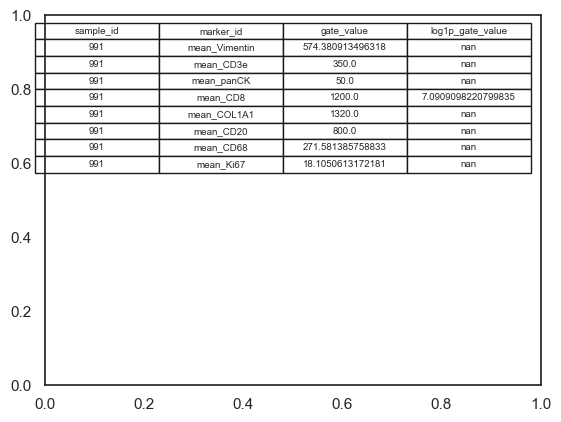

In [40]:
# too many CD8, that should be CD4

importlib.reload(utils)

utils.phenotype_with_gate_change(
    adata=adata,
    gates=pd.read_csv("../data/phenotyping/20241002_1135_gates.csv"),
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="991",
    marker = "mean_CD8",
    new_gate = 1200
)

2024-10-02 12:05:54.812 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----


2024-10-02 12:05:54.869 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 12:05:54.871 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 12:05:54.873 | INFO     | utils:phenotype_with_gate_change:305 - processed gate      marker       991
3  mean_CD8  7.313887
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:105: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_op

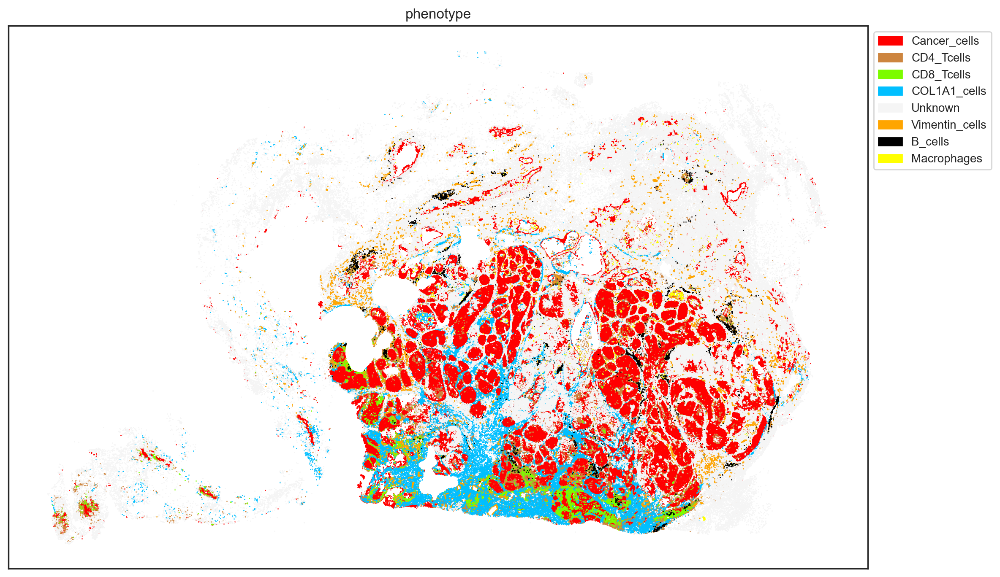

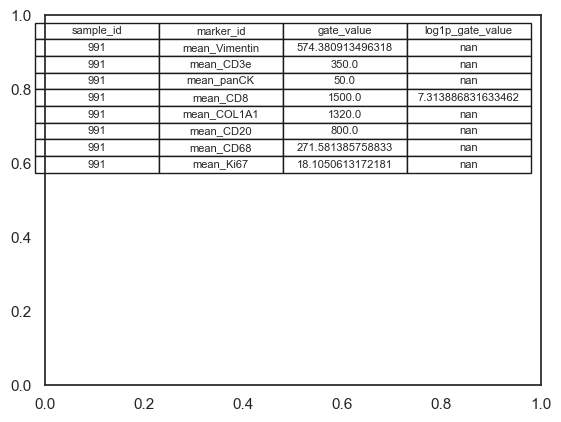

In [41]:
# too many CD8, that should be CD4

importlib.reload(utils)

utils.phenotype_with_gate_change(
    adata=adata,
    gates=pd.read_csv("../data/phenotyping/20241002_1135_gates.csv"),
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="991",
    marker = "mean_CD8",
    new_gate = 1500
)

2024-10-02 12:07:41.495 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----
2024-10-02 12:07:41.624 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 12:07:41.626 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 12:07:41.628 | INFO     | utils:phenotype_with_gate_change:305 - processed gate      marker       991
3  mean_CD8  7.346655
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:105: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprec

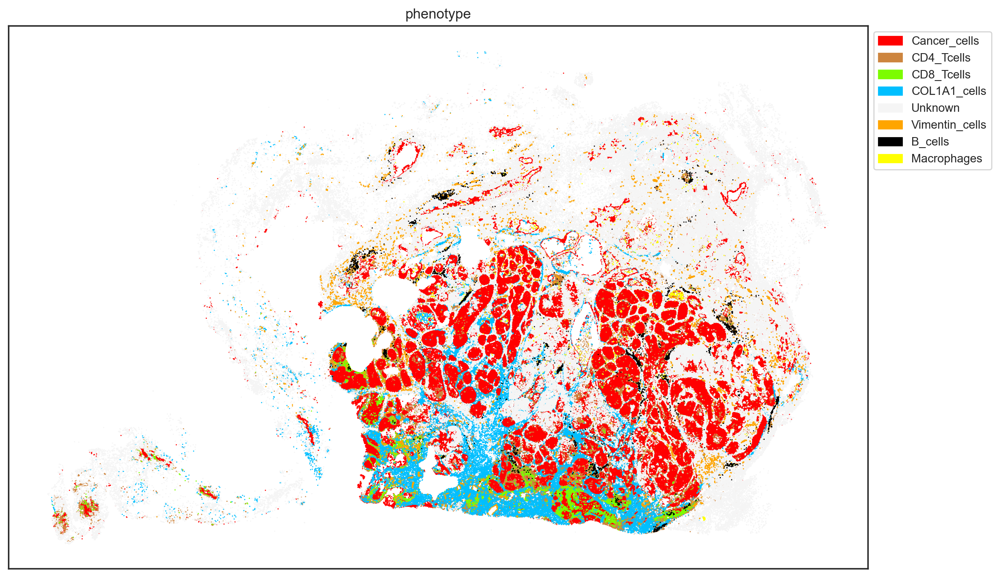

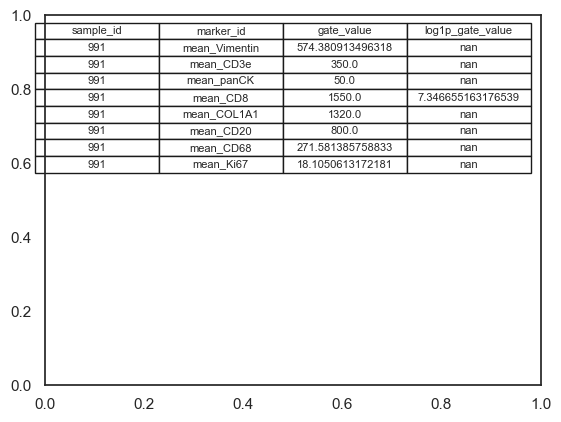

In [42]:
# too many CD8, that should be CD4

importlib.reload(utils)

utils.phenotype_with_gate_change(
    adata=adata,
    gates=pd.read_csv("../data/phenotyping/20241002_1135_gates.csv"),
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="991",
    marker = "mean_CD8",
    new_gate = 1550
)

2024-10-02 12:08:08.939 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----


2024-10-02 12:08:09.030 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 12:08:09.034 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 12:08:09.036 | INFO     | utils:phenotype_with_gate_change:305 - processed gate      marker       991
3  mean_CD8  7.378384
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:105: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_op

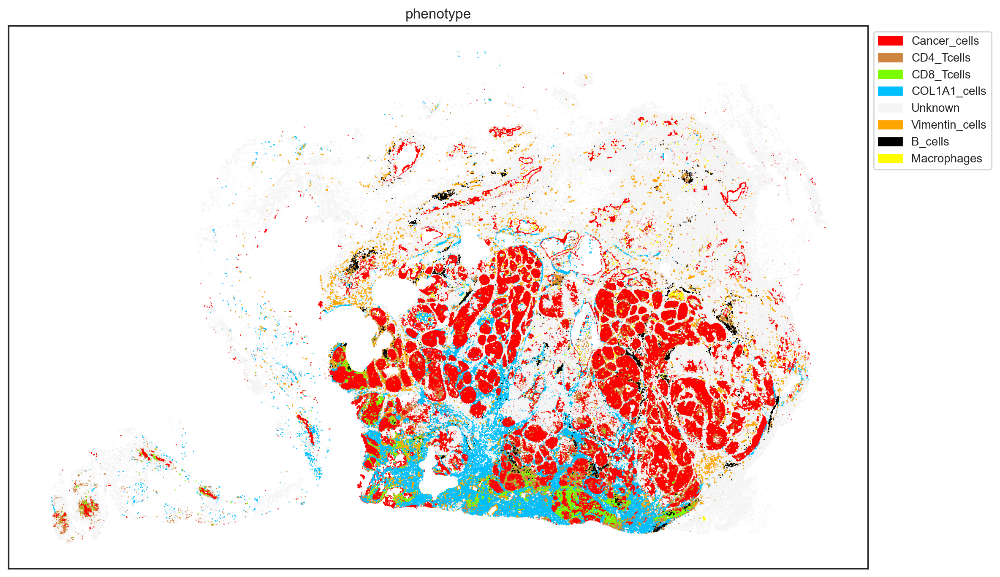

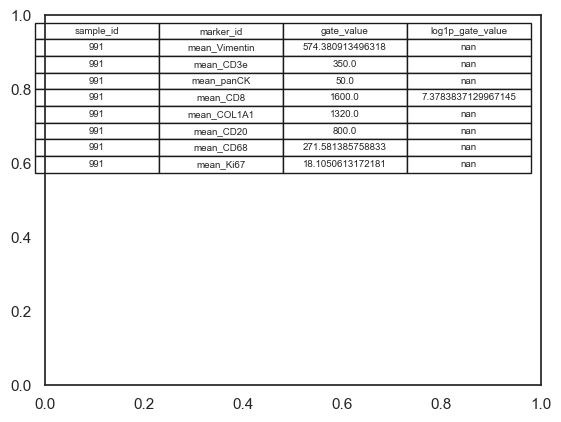

In [43]:
# too many CD8, that should be CD4

importlib.reload(utils)

utils.phenotype_with_gate_change(
    adata=adata,
    gates=pd.read_csv("../data/phenotyping/20241002_1135_gates.csv"),
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="991",
    marker = "mean_CD8",
    new_gate = 1600
)

2024-10-02 12:16:37.134 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----
2024-10-02 12:16:37.292 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 12:16:37.293 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 12:16:37.294 | INFO     | utils:phenotype_with_gate_change:305 - processed gate      marker       991
3  mean_CD8  7.378384
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:105: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprec

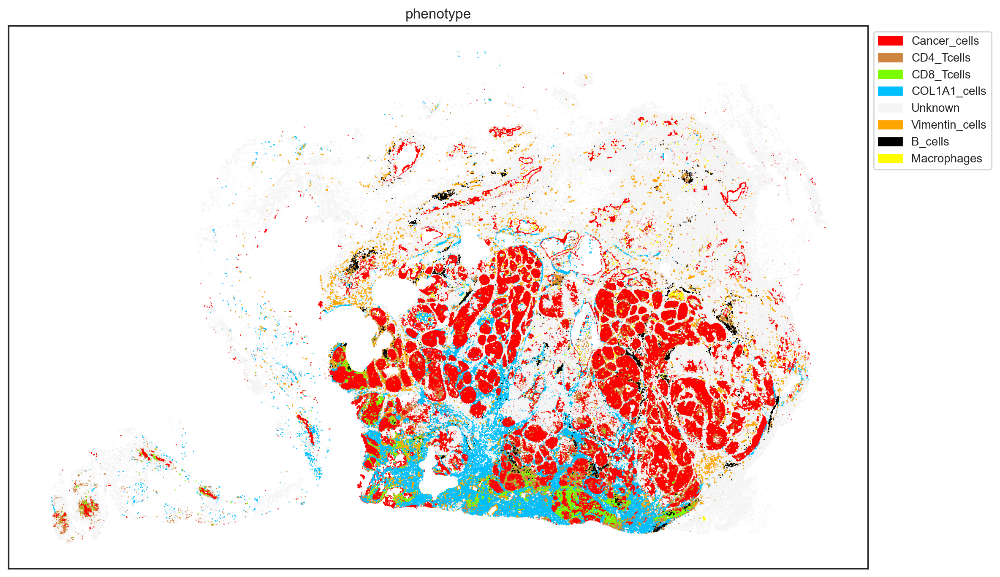

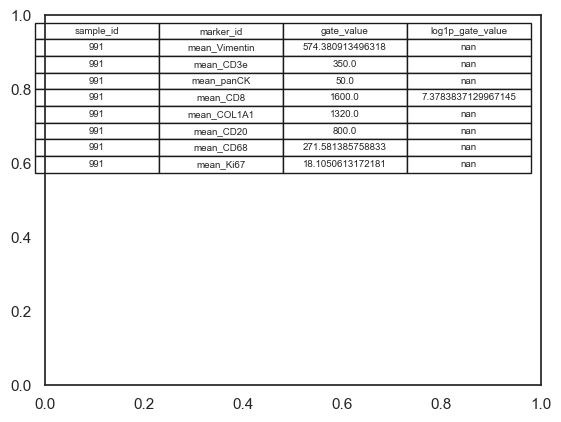

2024-10-02 12:16:50.935 | INFO     | utils:phenotype_with_gate_change:331 -  phenotyping saved in adata object


In [44]:
# too many CD8, that should be CD4

importlib.reload(utils)

adata = utils.phenotype_with_gate_change(
    adata=adata,
    gates=pd.read_csv("../data/phenotyping/20241002_1135_gates.csv"),
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="991",
    marker = "mean_CD8",
    new_gate = 1600,
    adata_in_place=True
)

In [46]:
adata.obs.columns

Index(['CellID', 'Y_centroid', 'X_centroid', 'Area', 'MajorAxisLength',
       'MinorAxisLength', 'Eccentricity', 'Orientation', 'Extent', 'Solidity',
       'filter_by_ann', 'mean_DAPI_bg_abs_above_value',
       'mean_DAPI_bg_abs_below_value', 'Area_filter_nottoobig',
       'Area_filter_nottoolow', 'Area_filter', 'DAPI_ratio',
       'DAPI_ratio_pass_nottoolow', 'DAPI_ratio_pass_nottoohigh',
       'DAPI_ratio_pass', 'imageid', 'phenotype'],
      dtype='object')

In [47]:
adata.write("../data/processed/20241002_1218_991_phenotyped.h5ad")

# Phenotype 992, to compare